In [4]:
import numpy as np
from numpy import asarray
import pandas as pd
import glob
import os
import matplotlib.pyplot as plt

from keras.models import load_model
from sklearn import preprocessing

import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import cv2
import random

In [7]:
tf.__version__

'2.2.0'

In [2]:
# avoid tensorflow to get all gpu memory
physical_devices = tf.config.list_physical_devices('GPU')
try:
    for gpu in physical_devices:
        tf.config.experimental.set_memory_growth(gpu, True)
except:
    logger.info('error accessing gpu devices...')
    pass

In [3]:
root_train = '../data/raw/vehicle/train/train/'

In [4]:
data_train = []

In [5]:
for category in sorted(os.listdir(root_train)):
    for file in sorted(os.listdir(os.path.join(root_train, category))):
        data_train.append((category, os.path.join(root_train, category, file)))

In [6]:
train_df = pd.DataFrame(data_train, columns=['classes','file_path']).sample(frac=1.0)
train_df.head()

,classes,file_path
8541,Boat,../data/raw/vehicle/train/train/Boat/003666_00...
2379,Boat,../data/raw/vehicle/train/train/Boat/000223_17...
12680,Bus,../data/raw/vehicle/train/train/Bus/005145_17.jpg
8815,Boat,../data/raw/vehicle/train/train/Boat/003841_18...
27210,Van,../data/raw/vehicle/train/train/Van/004858_09.jpg


In [7]:
cols=train_df['classes'].unique()
cols

array(['Boat', 'Bus', 'Van', 'Snowmobile', 'Car', 'Motorcycle',
       'Helicopter', 'Bicycle', 'Truck', 'PickUp', 'Ambulance', 'Taxi',
       'Limousine', 'Segway', 'Tank'], dtype=object)

Displaying 4 random image per vehicle category


<Figure size 432x288 with 0 Axes>

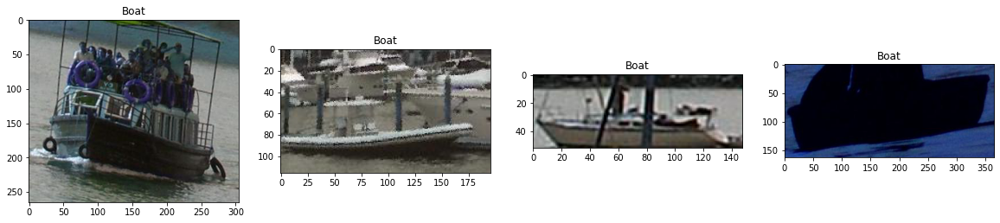

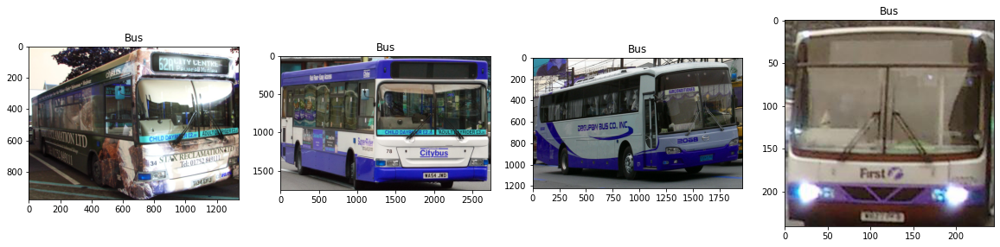

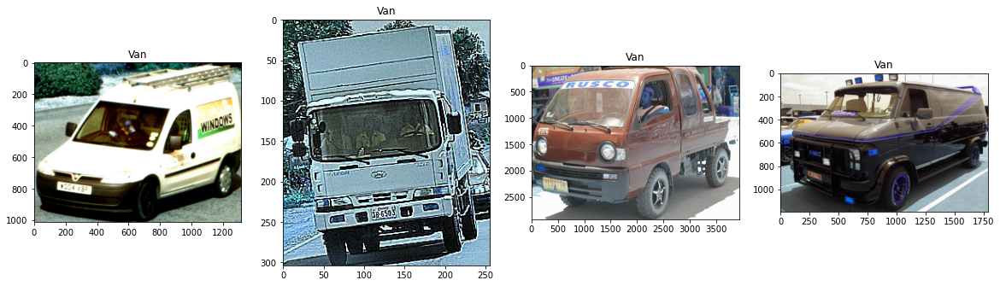

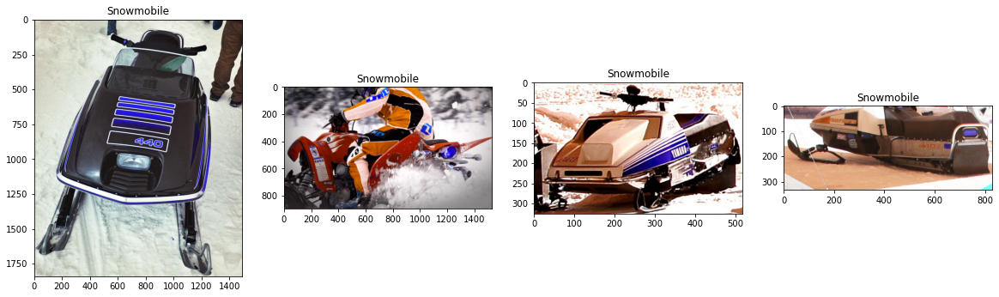

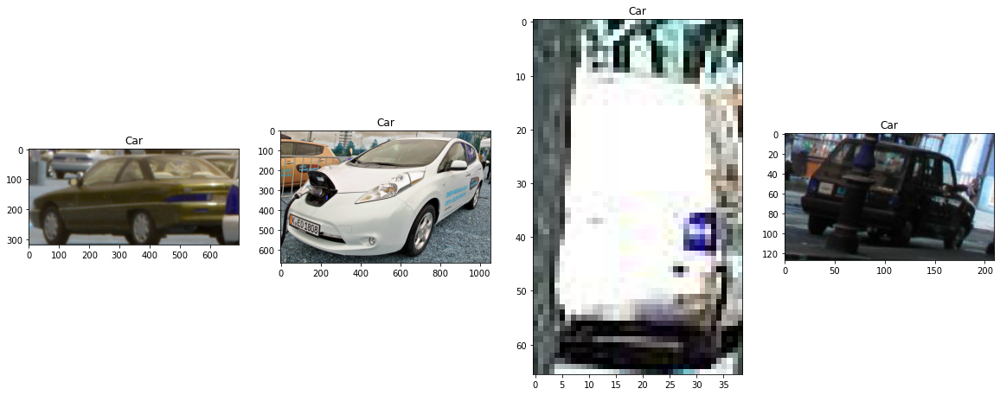

...

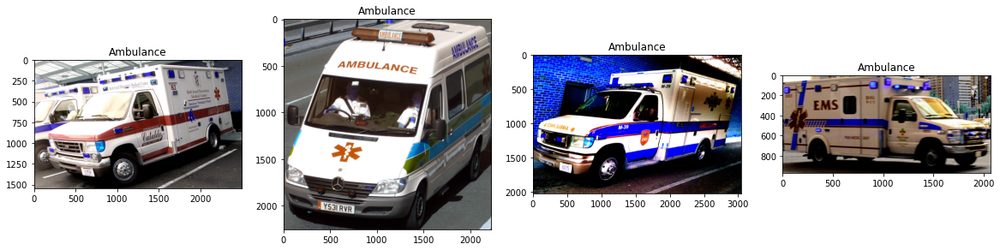

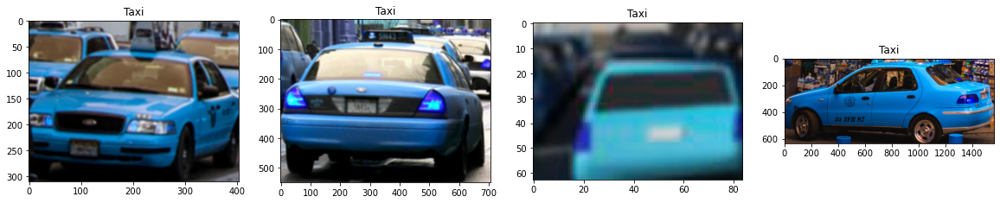

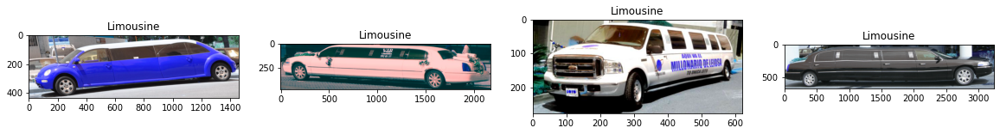

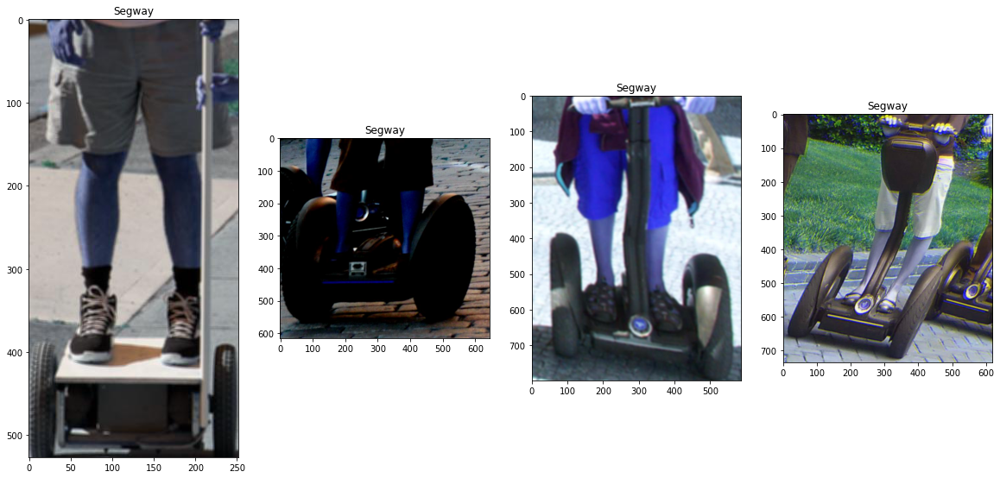

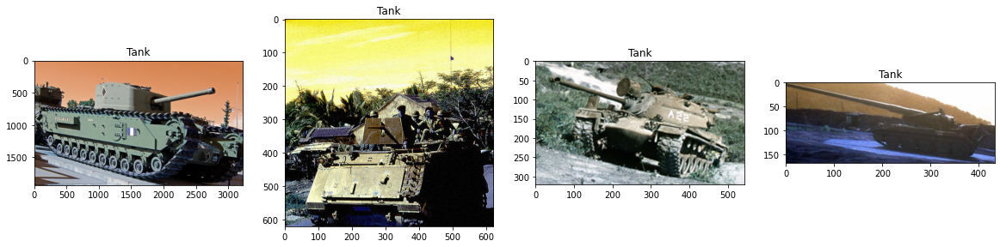

In [8]:
print("="*70)
print("Displaying 4 random image per vehicle category")
print("="*70)

# for every category in `cols`
for j in range(15):
    plt.figure(j)
    plt.figure(figsize=(20,20))
    
    # 4 images per every vehicle
    for i in range(4):
        id = "14{}".format(i+1)
        plt.subplot(int(id))
        random_file = random.choice(os.listdir(root_train + cols[j] + "/"))
        img = cv2.imread(root_train + cols[j] + "/" + random_file)
        plt.title(cols[j])
        plt.imshow(img)
plt.show()

In [9]:
root_test = '../data/raw/vehicle/test/proof/'

In [10]:
data_test = []
id_line = []

In [11]:
count = 0
for file in sorted(os.listdir(os.path.join(root_test))):
    data_test.append((os.path.join(root_test, file)))
    id_line.append(count)
    count += 1

In [12]:
test_df = pd.DataFrame(data_test, columns=['file_path'])
test_df.head()

,file_path
0,../data/raw/vehicle/test/proof/004688.jpg
1,../data/raw/vehicle/test/proof/004689.jpg
2,../data/raw/vehicle/test/proof/004690.jpg
3,../data/raw/vehicle/test/proof/004691.jpg
4,../data/raw/vehicle/test/proof/004692.jpg


In [13]:
test_generator = ImageDataGenerator(rescale=1. / 255.)

In [14]:
predict_generator = test_generator.flow_from_dataframe(
    dataframe=test_df,
    x_col='file_path',
    y_col=None,
    batch_size=32,
    shuffle=False,
    class_mode=None,
    target_size= (224, 224))

Found 31 validated image filenames.


### Testing with ResNet50 model

In [17]:
name = 'complete_model_sequential.h5'

In [18]:
network = load_model(f'../data/results/{name}')

In [19]:
network.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50 (Model)             (None, 2048)              23587712  
_________________________________________________________________
dense (Dense)                (None, 1024)              2098176   
_________________________________________________________________
dense_1 (Dense)              (None, 15)                15375     
Total params: 25,701,263
Trainable params: 25,648,143
Non-trainable params: 53,120
_________________________________________________________________


In [19]:
steps = len(test_df) // 2

In [58]:
proof = np.array(network.predict(predict_generator,
                                steps = steps,
                                verbose = 1,
                                workers = 10,
                                max_queue_size = 64))

15/15 [==============================] - 8s 513ms/step


In [21]:
label_names = ['Ambulance','Bicycle','Boat','Bus','Car','Helicopter','Limousine',
               'Motorcycle','PickUp','Segway','Snowmobile','Tank','Taxi','Truck','Van']

#### testing one image

In [28]:
test_df.iloc[0]

file_path    ../data/raw/vehicle/test/proof/000053.jpg
Name: 0, dtype: object

In [29]:
simulation = proof[0]
print(simulation)

[9.9999964e-01 1.1544608e-17 2.1794456e-13 1.8001447e-12 1.8792377e-12
 8.4789258e-16 6.2880202e-21 1.3418116e-16 1.1554407e-14 2.7917124e-18
 1.0281852e-19 5.6767603e-16 1.0940953e-14 4.2728465e-10 3.9068851e-07]


In [30]:
classes = np.argmax(simulation, axis = 0)
print(classes)

0


In [31]:
label_names[0]

'Ambulance'

#### testing the whole dataset

In [59]:
class_names = []
for j in range(len(test_df)):
    b = np.argmax(proof[j], axis = 0)
    class_names.append(label_names[b])

In [60]:
class_names

['Bicycle',
 'Boat',
 'Car',
 'Boat',
 'Car',
 'Bicycle',
 'Motorcycle',
 'Car',
 'Boat',
 'Car',
 'Boat',
 'Car',
 'Motorcycle',
 'Boat',
 'Motorcycle',
 'Car',
 'Boat',
 'Car',
 'Bicycle',
 'Bicycle',
 'Boat',
 'Boat',
 'Motorcycle',
 'PickUp',
 'Helicopter',
 'Van',
 'PickUp',
 'Boat',
 'Tank',
 'Motorcycle',
 'Car']

#### Plot the images with predicted label

In [27]:
root_test = "../data/raw/vehicle/test/proof"

In [28]:
import matplotlib.image as mpimg

/home/christian/miniconda3/envs/ironhack_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


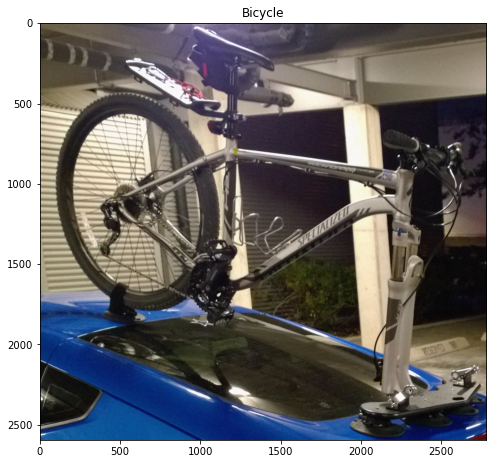

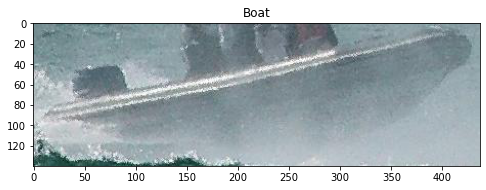

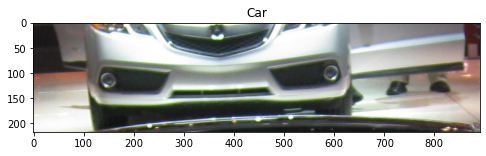

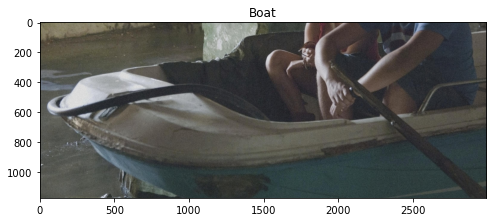

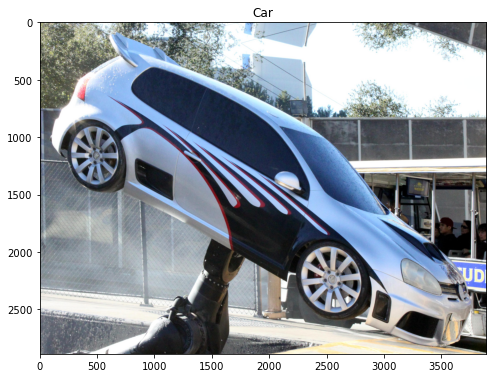

...

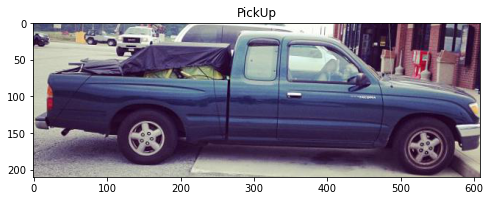

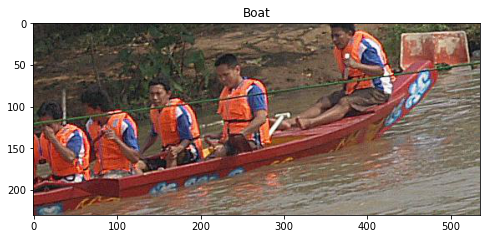

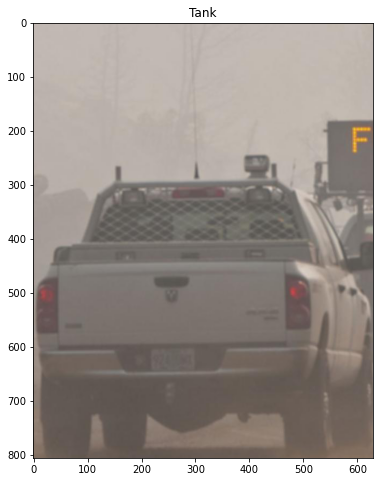

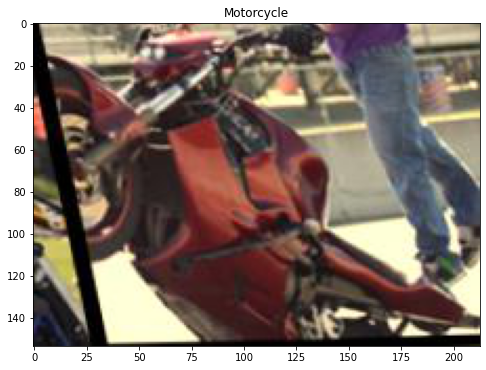

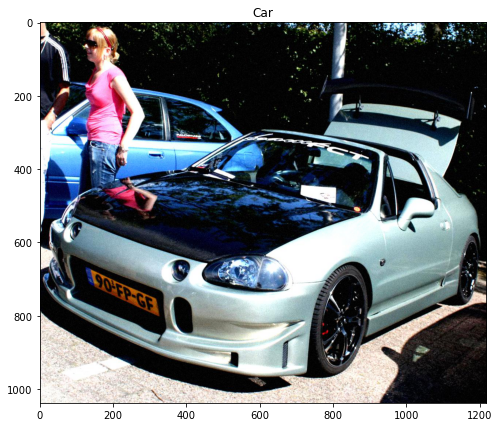

In [62]:
directory=sorted(os.listdir(root_test))
i=0
for each in directory:
    plt.figure(figsize=(8,8))
    img=mpimg.imread(f"../data/raw/vehicle/test/proof/{each}")
    imgplot = plt.imshow(img)
    plt.title(class_names[i])
    i+=1
plt.show()

### Testing with mobileNetV2 model

In [15]:
name2 = 'complete_model_model.h5'

In [16]:
network2 = load_model(f'../data/results/{name2}')

In [17]:
network2.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1_pad (ZeroPadding2D)       (None, 225, 225, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         Conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
______________________________________________________________________________________________

In [20]:
proof2 = np.array(network2.predict(predict_generator,
                                   steps = steps,
                                   verbose = 1,
                                   workers = 10,
                                   max_queue_size = 64))

15/15 [==============================] - 1s 47ms/step


In [25]:
class_names2 = []
for j in range(len(test_df)):
    b = np.argmax(proof2[j], axis = 0)
    class_names2.append(label_names[b])

In [26]:
class_names2

['Bicycle',
 'Boat',
 'Car',
 'Boat',
 'Car',
 'Bicycle',
 'Motorcycle',
 'Car',
 'Boat',
 'Car',
 'Boat',
 'Car',
 'Motorcycle',
 'Boat',
 'Motorcycle',
 'Car',
 'Boat',
 'Car',
 'Bicycle',
 'Bicycle',
 'Car',
 'Boat',
 'Motorcycle',
 'Truck',
 'Helicopter',
 'Van',
 'PickUp',
 'Boat',
 'PickUp',
 'Bicycle',
 'Car']

In [ ]:
root_test = "../data/raw/vehicle/test/proof"

In [ ]:
import matplotlib.image as mpimg

/home/christian/miniconda3/envs/ironhack_env/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


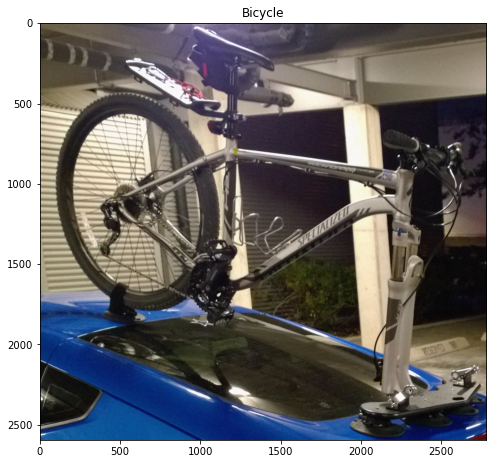

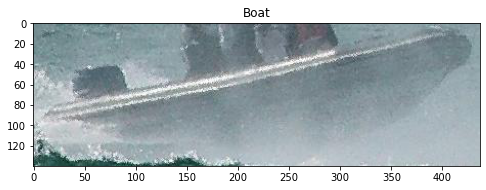

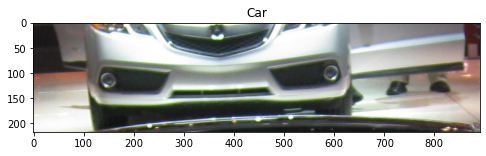

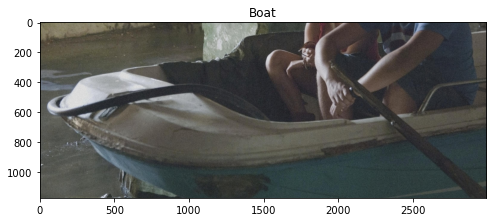

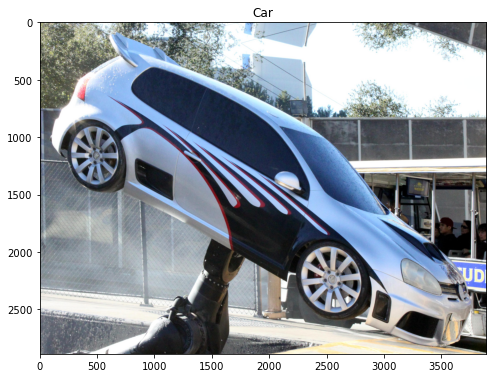

...

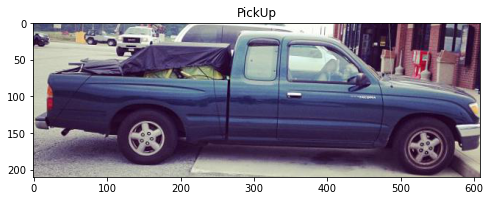

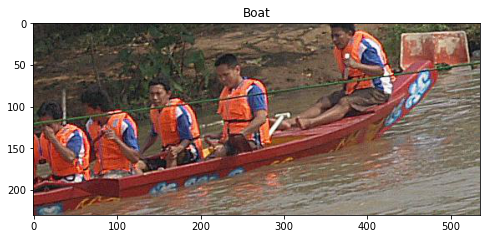

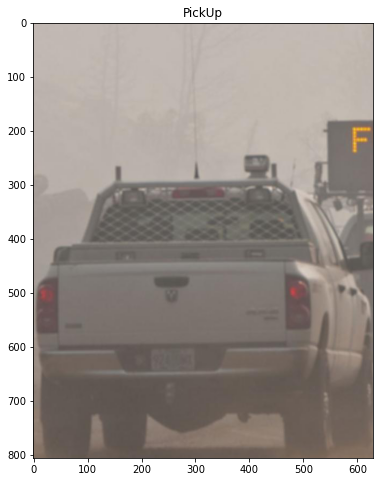

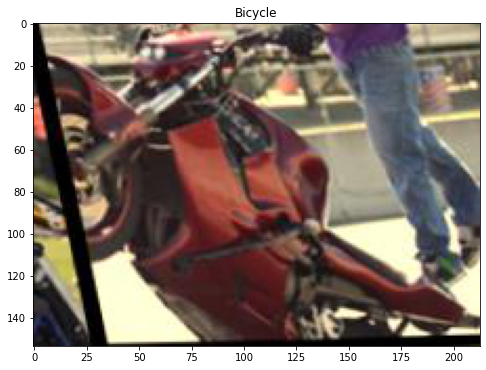

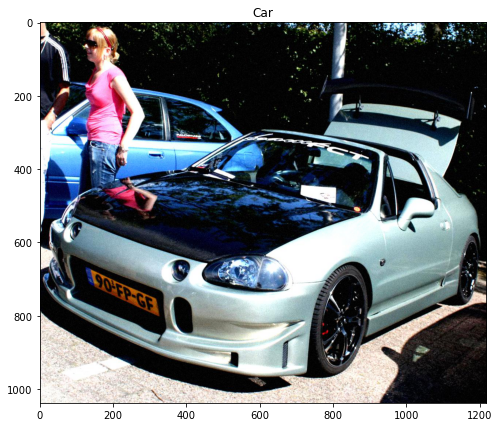

In [55]:
directory=sorted(os.listdir(root_test))
i=0
for each in directory:
    plt.figure(figsize=(8,8))
    img=mpimg.imread(f"../data/raw/vehicle/test/proof/{each}")
    plt.imshow(img)
    plt.title(class_names2[i])
    i+=1
plt.show()

In [85]:
directory

['004688.jpg',
 '004689.jpg',
 '004690.jpg',
 '004691.jpg',
 '004692.jpg',
 '004693.jpg',
 '004694.jpg',
 '004695.jpg',
 '004696.jpg',
 '004697.jpg',
 '004698.jpg',
 '004699.jpg',
 '004700.jpg',
 '004701.jpg',
 '004702.jpg',
 '004703.jpg',
 '004704.jpg',
 '004705.jpg',
 '004706.jpg',
 '004707.jpg',
 '004708.jpg',
 '004709.jpg',
 '004710.jpg',
 '004711.jpg',
 '004712.jpg',
 '004713.jpg',
 '004714.jpg',
 '004715.jpg',
 '004716.jpg',
 '004717.jpg',
 '004718.jpg']

### Plot the predictions

#### convert the image into array

In [31]:
img_data = asarray(img)

In [32]:
img_data = img_data / 255

In [49]:
img_data=cv2.resize(img_data,(255,255))

#### convert the labels into array

In [34]:
le = preprocessing.LabelEncoder()

In [35]:
le.fit(class_names2)

LabelEncoder()

In [36]:
le.classes_

array(['Bicycle', 'Boat', 'Car', 'Helicopter', 'Motorcycle', 'PickUp',
       'Truck', 'Van'], dtype='<U10')

In [37]:
label_data=le.transform(class_names2)
label_data

array([0, 1, 2, 1, 2, 0, 4, 2, 1, 2, 1, 2, 4, 1, 4, 2, 1, 2, 0, 0, 2, 1,
       4, 6, 3, 7, 5, 1, 5, 0, 2])

In [ ]:
# le.inverse_transform(label_data)

In [86]:
def plot_image_pred(images: str,
                    labels: np.ndarray,
                    preds: np.ndarray,
                    indexes: list,
                    class_names: list = None, 
                    figsize: tuple = (8, 4)):
            
        for index in indexes:
        
            predicted_probas = preds[index]
            true_index = labels[index]
            predicted_index = np.argmax(predicted_probas)
            
            if class_names:
                true_class = class_names[true_index]
                predicted_class = class_names[predicted_index]

            fig, axes = plt.subplots(ncols=2, nrows=1, figsize=figsize)

            directory=sorted(os.listdir(root_test))
            axes[0].imshow(mpimg.imread(f"../data/raw/vehicle/test/proof/{directory[index]}"));
            axes[0].axis('off')
            axes[0].set_title(f"predicted class: {predicted_class if class_names else predicted_index}", 
                              color='blue' if true_index == predicted_index else 'red')

            axes[1].barh(class_names if class_names else [str(i) for i in range(len(predicted_probas))],
                         predicted_probas, 
                         color='black')
            axes[1].get_children()[predicted_index].set_color('red')
            axes[1].get_children()[true_index].set_color('blue')
            axes[1].set_xlim(0, 1)
            axes[1].set_title("class probabilities")
            axes[1].set_xlabel("probability")
            axes[1].set_ylabel("class name")


            plt.tight_layout()
            plt.show()

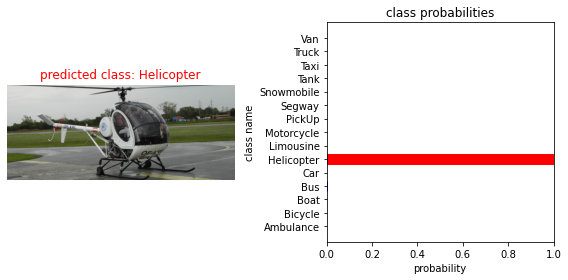

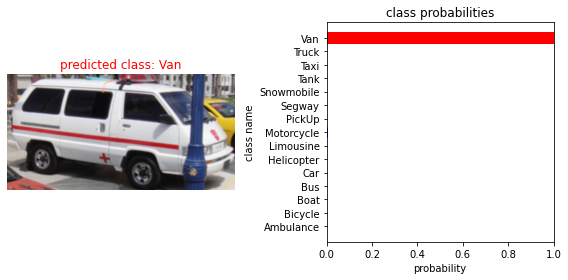

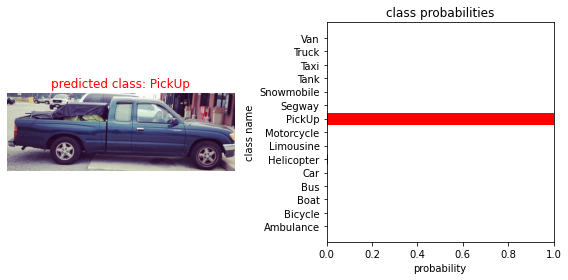

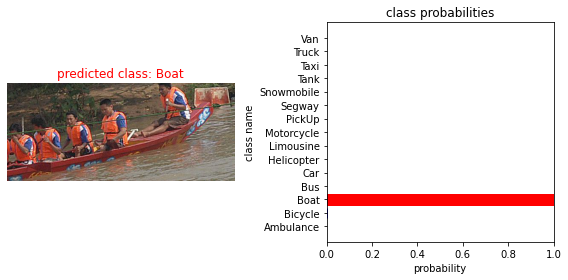

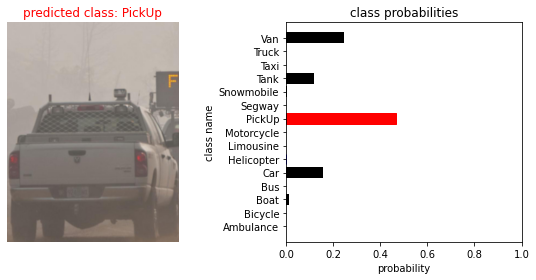

In [91]:
plot_image_pred(root_test,
                label_data,
                proof2, 
                indexes=[24,25,26,27,28], 
                class_names=label_names)